
<div style="background:#1A4D2E;width:900px;margin:auto;border-radius:8px;padding:8px">
    <h1 style="color:#E8DFCA;text-align:center;"> Medical Appointment No-Show Analysis</h1>
</div>

<h2 style="color:#F6995C;">table contain</h2>
<ul>
    <li><a href="#uni_analysis">Univariate Analysis</a></li>
        <ul>
            <li><a href='#target'>Target Columns</li>
            <li><a href='#cat'>Category Columns</li>
            <li><a href='#num'>numerical Columns</li>
        </ul>
    <li><a href="#bi_analysis">Bivariate Analysis</a></li>
    <li><a href="#Mult_analysis"> Multivariate Analysis</a></li>
</ul>

<a id='intro'></a>


<div style="background:#1A4D2E;width:900px;margin:auto;border-radius:8px;padding:8px,width:60px">
    <h1 style="color:#DBF227;text-align:center;">Import Libraries</h1>
</div>

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly_express as px
import klib 
import seaborn as sns
plt.style.use('fivethirtyeight')
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from scipy.stats import chi2_contingency
import warnings
warnings.filterwarnings('ignore')
from geopy.geocoders import Nominatim
import geocoder


In [2]:
df=pd.read_csv('../data/processed/patent_data.csv')

In [3]:
# show the first row of the data
df.head()

,Unnamed: 0,patient_id,appointment_id,gender,scheduled_day,appointment_day,age,neighbourhood,scholarship,hipertension,diabetes,alcoholism,handcap,sms_received,no_show
0,0,2.987250e+13,5642903,F,2016-04-29T18:38:08Z,2016-04-29T00:00:00Z,62,JARDIM DA PENHA,0,1,0,0,0,0,No
1,1,5.589978e+14,5642503,M,2016-04-29T16:08:27Z,2016-04-29T00:00:00Z,56,JARDIM DA PENHA,0,0,0,0,0,0,No
2,2,4.262962e+12,5642549,F,2016-04-29T16:19:04Z,2016-04-29T00:00:00Z,62,MATA DA PRAIA,0,0,0,0,0,0,No
3,3,8.679512e+11,5642828,F,2016-04-29T17:29:31Z,2016-04-29T00:00:00Z,8,PONTAL DE CAMBURI,0,0,0,0,0,0,No
4,4,8.841186e+12,5642494,F,2016-04-29T16:07:23Z,2016-04-29T00:00:00Z,56,JARDIM DA PENHA,0,1,1,0,0,0,No


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 110526 entries, 0 to 110525
Data columns (total 15 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   Unnamed: 0       110526 non-null  int64  
 1   patient_id       110526 non-null  float64
 2   appointment_id   110526 non-null  int64  
 3   gender           110526 non-null  object 
 4   scheduled_day    110526 non-null  object 
 5   appointment_day  110526 non-null  object 
 6   age              110526 non-null  int64  
 7   neighbourhood    110526 non-null  object 
 8   scholarship      110526 non-null  int64  
 9   hipertension     110526 non-null  int64  
 10  diabetes         110526 non-null  int64  
 11  alcoholism       110526 non-null  int64  
 12  handcap          110526 non-null  int64  
 13  sms_received     110526 non-null  int64  
 14  no_show          110526 non-null  object 
dtypes: float64(1), int64(9), object(5)
memory usage: 12.6+ MB


In [5]:
#change the dtype of scheduled_day,appointment_day  
df['scheduled_day']=pd.to_datetime(df['scheduled_day'])
df['appointment_day']=pd.to_datetime(df['appointment_day'])

<a id='uni_analysis'>
<div style="background:#222831;width:900px;margin:auto;border-radius:8px;padding:8px">
    <h1 style="color:#DBF227;text-align:center;">1-Univariate Analysis</h1>
</div>

<a id='target'>

<div style="background:#1A4D2E;width:500px;margin:auto;border-radius:8px;padding:5px">
    <h2 style="color:#F2F2F2;text-align:center;">1-Target Columns</h2>
</div>

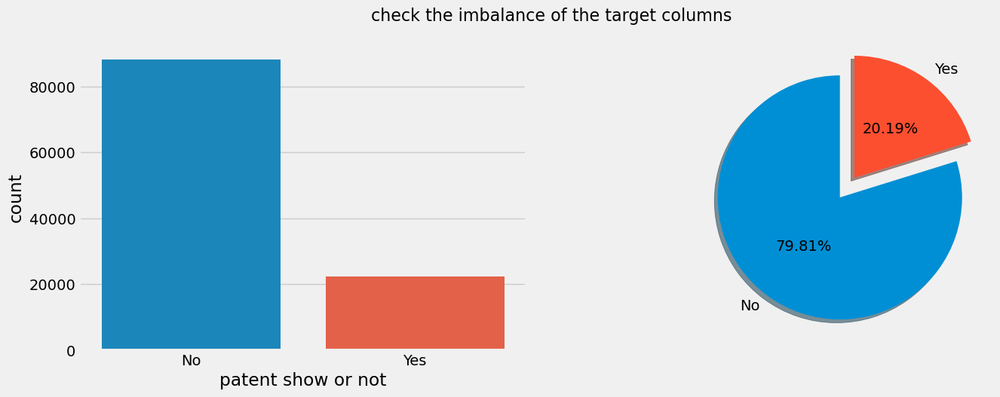

In [6]:
plt.rcParams['figure.figsize']=(15,5)

plt.subplot(1,2,1)
sns.countplot(df,x='no_show')
plt.xlabel('patent show or not')

plt.subplot(1,2,2)
df['no_show'].value_counts().plot(kind='pie',explode=(0.0,0.2),autopct='%0.2f%%',
                                startangle=90,pctdistance=0.5,shadow=True)
plt.suptitle('check the imbalance of the target columns ',fontsize=16)
plt.axis('off')

plt.show()

<div style="background: #1D1E26; width: 800px; color: #D9B4B7; border-radius: 10px; margin: auto; padding: 20px;">
    <h3 style="text-align:center;color:#15BFAE">Summary</h3>
    <ul>
        <li>The <code>no_show</code>  is imbalanced data where  There are 88,207 instances  No and There are 22,319 instances  Yes. </li>
    </ul>
</div>


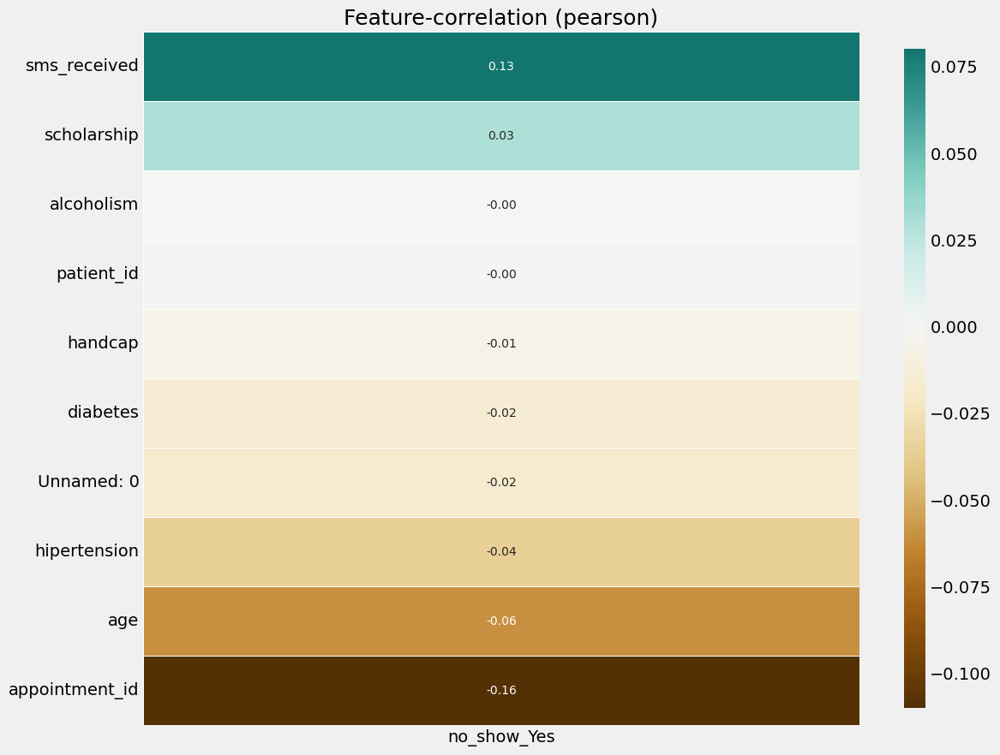

In [7]:
# here i went to see the corr between the feature and the target columns
# make a copy of data

# dummies the target columns to  0 and 1 
df=pd.get_dummies(df,columns=['no_show'],drop_first=True)
#plt. the corr table with the feature 
klib.corr_plot(df,target='no_show_Yes')
plt.show()

<div style="background: #1D1E26; width: 800px; color: #D9B4B7; border-radius: 10px; margin: auto; padding: 20px;">
    <h3 style="text-align:center;color:#15BFAE">Summary</h3>
    <ul>
        <li>It appears that receiving a text message <code>sms_received</code> has a slight positive effect on the likelihood of the patient not showing up for the appointment.</li>
        <li>Certain medical conditions such as diabetes and hypertension seem to have a slight negative effect on the likelihood of the patient not showing up for the appointment.</li>
        <li>Age and appointment ID seem to have a larger negative effect compared to others, with a greater decrease in the likelihood of the patient not showing up for the appointment.
</li>
    </ul>
</div>


<a id='cat'>

<div style="background:#643843;width:500px;margin:auto;border-radius:8px;padding:5px">
    <h2 style="color:#F2F2F2;text-align:center;">2-Category Columns</h2>
</div>

In [8]:
def plot_pie_barchar(df,var,title=''):
    label_list=list(df[var].value_counts().index)
    values=df[var].value_counts().values

    #create subplots :1rows 2 columns
    fig=make_subplots(rows=1,cols=2,specs=[[{'type':'domain'},{'type':'bar'}]])

    #first plot
    fig.add_trace(go.Pie(labels=label_list,values=values,name='Distribution',),1,1)
    fig.add_trace(go.Bar(y=label_list,x=values,name='Count',orientation='h',hoverinfo='x+y'),1,2)

    fig.update_layout(title_text=f'Distribution and count of {var} cases {title}',title_x=0.5,title_font=dict(size=20))
    fig.update_xaxes(title_text='Count', row=1, col=2)
    fig.update_yaxes(title_text='Category', row=1, col=2)

    
    return fig.show()


In [9]:
plot_pie_barchar(df,'gender')

<div style="background: #1D1E26; width: 800px; color: #D9B4B7; border-radius: 10px; margin: auto; padding: 20px;">
    <h3 style="text-align:center;color:#15BFAE">Summary</h3>
    <ul>
        <li>we can observe that there are significantly more females represented in the dataset compared to males.There are 71,839 entries classified as Female (F) and 38,687 entries classified as Male (M).</li>
    </ul>
</div>


In [10]:
#plot neighbourhood
neighbourhood= df['neighbourhood'].value_counts().reset_index()
fig=px.bar(neighbourhood,x='neighbourhood',y='count',text='count',title='Distrbution of neighbourhood')

fig.update_layout(title_font=dict(size=20,color='red'),title_x=0.5,xaxis_title='Neighbourhood', yaxis_title='Count')
fig.update_traces(marker_color='skyblue',texttemplate='%{text}',textposition='outside')
fig.update_xaxes(title_font=dict(size=16), tickfont=dict(size=12), tickangle=45)
fig.update_yaxes(title_font=dict(size=16), tickfont=dict(size=12))


<div style="background: #1D1E26; width: 800px; color: #D9B4B7; border-radius: 10px; margin: auto; padding: 20px;">
    <h3 style="text-align:center;color:#15BFAE">Summary</h3>
    <ul>
        <li><code>neighbourhoods </code>has 81 unique value</li>
        <li>the most frequent neighbourhood is JARDIM CAMBURI,The fact that "JARDIM CAMBURI" is the most frequent neighborhood suggests that a significant portion of the individuals in the dataset reside in this particular area.  </li>
    </ul>
</div>


In [11]:
#plot scholarship
plot_pie_barchar(df,'scholarship')

<div style="background: #1D1E26; width: 800px; color: #D9B4B7; border-radius: 10px; margin: auto; padding: 20px;">
    <h3 style="text-align:center;color:#15BFAE">Summary</h3>
    <ul>
        <li><code>scholarship </code>has 2 unique value</li>
        <li>10,861 patients are enrolled in the welfare program (scholarship value = 1).</li>
        <li>99,665 patients are not enrolled in the welfare program (scholarship value = 0).</li>
    </ul>
    <p style="text-align:center;">This suggests that a small proportion of patients (about 9.8%) are enrolled in the welfare program, while the majority (about 90.2%) are not</p>
</div>


In [12]:
# plot hipertension
plot_pie_barchar(df,'hipertension')

<div style="background: #1D1E26; width: 800px; color: #D9B4B7; border-radius: 10px; margin: auto; padding: 20px;">
    <h3 style="text-align:center;color:#15BFAE">Summary</h3>
    <ul>
        <li><code>hipertension </code>has 2 unique value</li>
        <li>21,801 patients have hypertension (Hipertension value = 1).</li>
        <li>88,725 patients do not have hypertension (Hipertension value = 0).</li>
    </ul>
    <p style="text-align:center;">This suggests that approximately 19.8% of patients in the dataset have hypertension, while the remaining 80.2% do not</p>
</div>


In [13]:
plot_pie_barchar(df,'diabetes')

<div style="background: #1D1E26; width: 800px; color: #D9B4B7; border-radius: 10px; margin: auto; padding: 20px;">
    <h3 style="text-align:center;color:#15BFAE">Summary</h3>
    <ul>
        <li><code>diabetes </code>has 2 unique value</li>
        <li>7,943 patients have diabetes (Diabetes value = 1).</li>
        <li>102,583 patients do not have diabetes (Diabetes value = 0).</li>
    </ul>
    <p style="text-align:center;">This indicates that approximately 7.2% of patients in the dataset have diabetes, while the remaining 92.8% do not.</p>
</div>


In [14]:
plot_pie_barchar(df,'alcoholism')

<div style="background: #1D1E26; width: 800px; color: #D9B4B7; border-radius: 10px; margin: auto; padding: 20px;">
    <h3 style="text-align:center;color:#15BFAE">Summary</h3>
    <ul>
        <li><code>alcoholism </code>has 2 unique value</li>
        <li>3,360 patients are classified as alcoholic (Alcoholism value = 1).</li>
        <li>107,166 patients are not classified as alcoholic (Alcoholism value = 0).</li>
    </ul>
    <p style="text-align:center;">This indicates that approximately 3% of patients in the dataset are classified as alcoholic, while the remaining 97% are not. </p>
</div>


In [15]:
plot_pie_barchar(df,'handcap')

<div style="background: #1D1E26; width: 800px; color: #D9B4B7; border-radius: 10px; margin: auto; padding: 20px;">
    <h3 style="text-align:center;color:#15BFAE">Summary</h3>
    <ul>
        <li><code>handcap </code>has 5 unique value</li>
        <li>108,285 patients do not have any reported disabilities (Handcap value = 0).</li>
        <li>2,042 patients have one disability (Handcap value = 1).</li>
        <li>183 patients have two disabilities (Handcap value = 2).</li>
        <li>13 patients have three disabilities (Handcap value = 3).</li>
        <li>3 patients have four disabilities (Handcap value = 4).
</li>
    </ul>
    <p style="text-align:center;">This information suggests that the majority of patients (about 99.1%) do not have reported disabilities. However, there are patients with varying degrees of disabilities,with a small proportion having multiple disabilities.</p>
</div>


In [16]:
plot_pie_barchar(df,'sms_received')

<div style="background: #1D1E26; width: 800px; color: #D9B4B7; border-radius: 10px; margin: auto; padding: 20px;">
    <h3 style="text-align:center;color:#15BFAE">Summary</h3>
    <ul>
        <li><code>sms_received </code>has 2 unique value</li>
        <li>75,044 patients did not receive any SMS messages (sms_received value = 0).</li>
        <li>35,482 patients received at least one SMS message (sms_received value = 1).</li>
    </ul>
    <p style="text-align:center;">This indicates that approximately 32% of patients received at least one SMS message, while the remaining 68% did not.</p>
</div>


<a id='num'>

<div style="background:#643843;width:500px;margin:auto;border-radius:8px;padding:5px">
    <h2 style="color:#F2F2F2;text-align:center;">3-numerical  Columns</h2>
</div>

In [17]:
#plot age distribution 
fig=px.histogram(df,x='age',title='Distribution of Age')
fig.update_layout(title_text='Distribution of Age',xaxis_title_text='Age',yaxis_title_text='count'
                ,bargap=0.2,bargroupgap=0.1,dragmode='pan',hovermode='x')

<a id='bi_analysis'>
<div style="background:#4C4A59;width:900px;margin:auto;border-radius:8px;padding:8px">
    <h1 style="color:#DBF227;text-align:center;">2. Bivariate Analysis</h1>
</div>

In [18]:
#gender not show 
gender_show=pd.crosstab(df.gender,df.no_show_Yes)
fig=px.bar(gender_show,x=gender_show.index,y=[True,False],barmode='group',text='value',
    labels={'value':'Count','gender':'Gender'},color_discrete_sequence=px.colors.sequential.Agsunset,template='plotly_dark',title='Gender Count for No_Show Patient')
fig.update_traces(texttemplate='%{value}',textposition='outside')
fig.update_layout(title_font=dict(size=20,color='red'),title_x=0.5)
fig.update_yaxes(range=(0,70000))

In [19]:
import plotly.express as px
gender_rate=df.groupby('gender')['no_show_Yes'].mean().reset_index()

fig = px.pie(data_frame=gender_rate, names='gender', values='no_show_Yes',
            title='No-Show Rate by Gender',
            color_discrete_sequence=px.colors.sequential.Agsunset,
            hole=0.3,
            labels={'gender': 'Gender', 'no_show_Yes': 'No-Show Count'},
            hover_data={'gender': True, 'no_show_Yes': True},
            template='plotly_dark')  

fig.update_traces(textinfo='percent+label', pull=[0.1, 0], textposition='inside',
                hoverinfo='label+percent+value', marker=dict(line=dict(color='black', width=2)))


fig.show()


In [20]:
# make hypothesis testing on the relationship between gender and no-show appointments

#Null Hypothesis: There is no association between gender and appointment attendance.
#Alternative Hypothesis: There is an association between gender and appointment attendance.
chi2, p, dof, expected = chi2_contingency(gender_show)

print("Chi-square statistic:", chi2)
print("P-value:", p)

Chi-square statistic: 1.8564579422090786
P-value: 0.17303416173736574


<div style="background: #1D1E26; width: 800px; color: #D9B4B7; border-radius: 10px; margin: auto; padding: 20px;">
    <h3 style="text-align:center;color:#15BFAE">Summary</h3>
    <ul>
        <li><b> Gender Distribution </b></li>
            <ul>
                <li>There are 71,839 Female patient and 38,687 male patient in the datasets </li>
            </ul>
        <li><b> No_show Rates</b> </li>
            <ul>
                <li><b> Female Patient </b></li>
                <ul>
                    <li>14,594 appointments were no show</li>
                    <li>no show rate is 20% </li>
                </ul>
                <li><b> male Patient </b></li>
                <ul>
                    <li>7,725  appointments were no show</li>
                    <li>no show rate is 19% </li>
                </ul>
            </ul>
        <li><b> Gender and no_show corr </b></li>
            <ul>
                <li>The p-value (0.173) is greater than the chosen significance level (0.05).</li>
            </ul>
    </ul>
    <p style="text-align:center;color:blue">we can see that the No-show rates are similar between genders, but there is a slightly higher rate of no-shows among female patients.and we fail to reject  the null hypothesis,so There is no association between gender and appointment attendance. </p>
</div>


In [21]:
fig=px.histogram(df,x='age',color='no_show_Yes',title="Distribution of Age by No-show status",
            labels={'age':'Age'},
            marginal='box',opacity=0.7,histnorm='percent',
            color_discrete_sequence=['#1f77b4', '#ff7f0e'],
            template='plotly_dark')

fig.update_layout(title_font=dict(size=20),title_x=0.5)
fig.update_xaxes(title_font=dict(size=16), tickfont=dict(size=12))
fig.update_yaxes(title_font=dict(size=16), tickfont=dict(size=12))


In [22]:
bins=[0,3,12,20,35,50,np.inf]
labels=['Infant','Child','Adolescent','Adult','Mid_age','Late adulthood']
df['age_group']=pd.cut(df['age'],labels=labels,bins=bins,right=False)
age_show=pd.crosstab(df.age_group,df.no_show_Yes)


In [23]:
fig=px.bar(age_show,
    x=age_show.index,
    y=[False,True],
    barmode='group',
    labels={'age_group':'Age Group','value':'Count'},
    text='value',
    title='Distribution of show/no-show by age' ,
    color_discrete_sequence=px.colors.sequential.Agsunset,
    template='plotly_dark')

fig.update_traces(textposition='outside')
fig.update_layout(title_x=0.5,title_font=dict(size=20))
fig.update_xaxes(title_font=dict(size=16))
fig.update_yaxes(title_font=dict(size=16),range=(0,35000))

In [24]:
no_show_age_rate=(df.groupby('age_group')['no_show_Yes'].mean().reset_index())
no_show_age_rate['no_show_Yes']=no_show_age_rate['no_show_Yes']*100
fig=px.bar(no_show_age_rate,x='age_group',y='no_show_Yes',
    labels={'no_show_Yes':'count',
    'age_group':'Age Group'},title='No show Rate by Age Group',
    text='no_show_Yes',template='plotly_dark',
    color_discrete_sequence=px.colors.sequential.Agsunset)
fig.update_yaxes(title_font=dict(size=16),range=(0,50))
fig.update_traces(texttemplate='%{y:.2f}%',textposition='outside')
fig.update_layout(title_x=0.5,title_font=dict(size=20))


<div style="background: #1D1E26; width: 800px; color: #D9B4B7; border-radius: 10px; margin: auto; padding: 20px;">
    <h3 style="text-align:center;color:#15BFAE">Summary</h3>
    <h5>General</h5>
    <ul>
    <li> The mean age of patients who showed up for their appointments (37.79) is slightly higher than the mean age of patients who missed their appointments (34.32). This indicates that, on average, patients who showed up tend to be older than those who missed their appointments.</li>
    </ul>
    <h5>Age Group</h5>
    <ul>
        <li><b>Infant:</b> 6,124 patients showed up for appointments, while 1,306 patients did not,the mean percentage of patients who didn't show up for appointments is <code> 17.58%. </code> </li>
        <li><b> Child:</b> 9,785 patients showed up for appointments, while 2,729 patients did not,the mean percentage of patients who didn't show up for appointments is <code> 21.81%. </code> </li>
        <li><b> Child:</b> 9,785 patients showed up for appointments, while 2,729 patients did not,the mean percentage of patients who didn't show up for appointments is <code> 21.81%. </code> </li>
        <li><b> Adolescents :</b> 7,761 patients showed up for appointments, while 2,706 patients did not,the mean percentage of patients who didn't show up for appointments is <code>  25.85%. </code> </li>
        <li><b> Adult :</b> 16,144 patients showed up for appointments, while 5,070 patients did not.,the mean percentage of patients who didn't show up for appointments is <code>   23.90%%. </code> </li>
        <li><b> Mid_age :</b> 17,375 patients showed up for appointments, while 4,490 patients did not,the mean percentage of patients who didn't show up for appointments is <code>   20.54%. </code> </li>
        <li><b> Late adulthood :</b> 31,018 patients showed up for appointments, while 6,018 patients did not,the mean percentage of patients who didn't show up for appointments is <code>    16.25%  </code> </li>
    </ul>
</div>

In [25]:
heighbour_show=pd.crosstab(df.neighbourhood,df.no_show_Yes)
fig=px.bar(heighbour_show,x=heighbour_show.index,y=[False,True],barmode='group',color_discrete_sequence=px.colors.sequential.Agsunset,
    template='plotly_dark',height=500)
fig.update_layout(
    title='No-show by Neighborhood',
    xaxis_title='Neighborhood',
    yaxis_title='Count',
    legend_title='No-show',
    hovermode='closest',
    
)
fig.update_layout(title_x=0.5,title_font=dict(size=20))

fig.update_xaxes(
    tickangle=45,  
    tickfont=dict(size=12),  
)

In [26]:
neighbourhood=df.groupby('neighbourhood')['no_show_Yes'].mean().reset_index()
neighbourhood['no_show_Yes']=neighbourhood['no_show_Yes']*100

fig=px.bar(neighbourhood,x='neighbourhood',y='no_show_Yes',
    labels={'no_show_Yes':'average',
    'age_group':'Age Group'},title='No show Rate by neighbourhood',
    text='no_show_Yes',template='plotly_dark',
    color_discrete_sequence=px.colors.sequential.Agsunset,height=500)
fig.update_yaxes(title_font=dict(size=16),range=(0,200))
fig.update_xaxes(tickangle=45,tickfont=dict(size=12))
fig.update_traces(texttemplate='%{y:.2f}%',textposition='outside')
fig.update_layout(title_x=0.5,title_font=dict(size=20))


<div style="background: #1D1E26; width: 800px; color: #D9B4B7; border-radius: 10px; margin: auto; padding: 20px;">
    <h3 style="text-align:center;color:#15BFAE">Summary</h3>
    <ul>
        <li>The neighborhoods with the highest no-show rates include ILHAS OCEÂNICAS DE TRINDADE (100%), ITARARÉ (26.27%), SANTA CECÍLIA (27.46%), SANTA CLARA (26.48%), and SANTOS DUMONT (28.92%).</li>
    </ul>

</div>

In [27]:
# what about scholarship
scholar_show=pd.crosstab(df.scholarship,df.no_show_Yes)
fig=px.bar(scholar_show,x=scholar_show.index,y=[False,True],barmode='group',text='value',color_discrete_sequence=px.colors.sequential.Agsunset,
    template='plotly_dark',title='No-show by Neighborhood')
fig.update_traces(textposition='outside')
fig.update_layout(title_x=0.5)
fig.update_yaxes(range=(0,100000))

In [28]:
def subplot_analysis(df,var):
    fig=make_subplots(rows=1,cols=2,specs=[[{'type':'domain'},{'type':'bar'}]])
    # plot Pie plot 
    var_rate=df.groupby(var)['no_show_Yes'].mean().reset_index()
    var_rate['no_show_Yes']=round(var_rate['no_show_Yes']*100,2)
    fig.add_trace(go.Pie(labels=var_rate[var], values=var_rate['no_show_Yes'],
                    hole=0.3,marker=dict(colors=px.colors.sequential.Agsunset)), 1, 1)
    fig.update_traces(
        textinfo='value+label',  
        pull=[0.1, 0],  
        textposition='inside',  
        hoverinfo='label+percent+value',
        showlegend=False
    ) 
    # plot bar plot 
    var_show=pd.crosstab(df[var],df.no_show_Yes)    
    fig.add_trace(go.Bar(x=var_show.index, y=var_show[False], name='False',text=var_show[False]), row=1, col=2)
    fig.add_trace(go.Bar(x=var_show.index, y=var_show[True], name='True',text=var_show[True]), row=1, col=2)
    fig.update_layout(title_text=f'Analysis of No-Show Rates and Appointments by {var}',title_x=0.5, title_font=dict(size=20),
                title_font_color="white",font=dict(color="white"),plot_bgcolor="rgba(0,0,0,0)",paper_bgcolor="rgba(0,0,0,0)",
                height=500)
    fig.update_traces(textposition='outside',row=1,col=2)
    fig.update_xaxes(title_text=f"{var}", row=1, col=2)
    fig.update_yaxes(title_text="Count", row=1, col=2)
    return fig

In [29]:
#plot analsis for scholarship
subplot_analysis(df,'scholarship')

<div style="background: #1D1E26; width: 800px; color: #D9B4B7; border-radius: 10px; margin: auto; padding: 20px;">
    <h3 style="text-align:center;color:#15BFAE">Summary</h3>
    <ul>
        <li>For the patient without a Scholarship (scholarship=0) ,the no show rate is <code>19.81</code> </li>
        <li>For the patient with a Scholarship (scholarship=1) ,the no show rate is <code>23.74</code> </li>
    </ul>
    <p style="text-align:center;color:blue">we can see that the patient with scholarship has a higher rate than the patient with scholarship</p>
</div>

In [30]:
subplot_analysis(df,'hipertension')

<div style="background: #1D1E26; width: 800px; color: #D9B4B7; border-radius: 10px; margin: auto; padding: 20px;">
    <h3 style="text-align:center;color:#15BFAE">Summary</h3>
    <ul>
        <li>Patients without hypertension have a slightly higher no-show rate (approximately 20.90%) compared to patients with hypertension (approximately 17.30%).</li>
    </ul>
</div>

In [31]:
subplot_analysis(df,'diabetes')

<div style="background: #1D1E26; width: 800px; color: #D9B4B7; border-radius: 10px; margin: auto; padding: 20px;">
    <h3 style="text-align:center;color:#15BFAE">Summary</h3>
    <ul>
        <li>Patients without diabetes have a slightly higher no-show rate (approximately 20.36%) compared to patients with diabetes (approximately 18%).</li>
    </ul>
</div>

In [32]:
subplot_analysis(df,'alcoholism')

<div style="background: #1D1E26; width: 800px; color: #D9B4B7; border-radius: 10px; margin: auto; padding: 20px;">
    <h3 style="text-align:center;color:#15BFAE">Summary</h3>
    <ul>
        <li>We can say that the average between them is very close</li>
    </ul>
</div>

In [33]:
subplot_analysis(df,'handcap')

<div style="background: #1D1E26; width: 800px; color: #D9B4B7; border-radius: 10px; margin: auto; padding: 20px;">
    <h3 style="text-align:center;color:#15BFAE">Summary</h3>
    <ul>
        <li>Patients with a handicap level of 0 have a no-show rate of approximately 20.24%.</li>
        <li>Patients with a handicap level of 1 have a slightly lower no-show rate of approximately 17.92%.
</li>
        <li>Patients with a handicap level of 2 have a similar no-show rate to those with a handicap level of 0, at approximately 20.22%.
</li>
        <li>Patients with a handicap level of 3 have a higher no-show rate of approximately 23.08%.
</li>
        <li>Patients with a handicap level of 4 have the highest no-show rate, at approximately 33.33%.
</li>
    </ul>
    <p>
This suggests that the no-show rate tends to increase with the level of handicap, although there is a slight decrease from level 0 to 1</p>
</div>

In [34]:
subplot_analysis(df,'sms_received')

<div style="background: #1D1E26; width: 800px; color: #D9B4B7; border-radius: 10px; margin: auto; padding: 20px;">
    <h3 style="text-align:center;color:#15BFAE">Summary</h3>
    <ul>
        <li>For patients who did not receive an SMS (0), the no-show rate is 16.703534%.
</li>
        <li>For patients who received an SMS (1), the no-show rate is 27.574545%.</li>
    </ul>
    <p>
This suggests that the no-show rate is higher for patients who received an SMS</p>
</div>

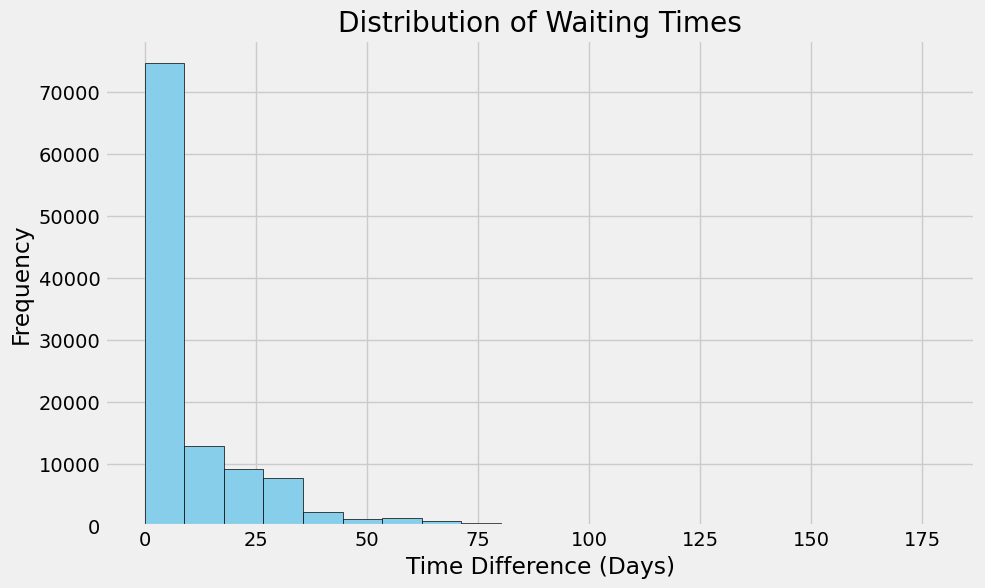

In [35]:
df['time_diff']=abs((df['appointment_day']-df['scheduled_day']) )
df['time_diff']=df['time_diff'].dt.days
plt.figure(figsize=(10, 6))
plt.hist(df['time_diff'], bins=20, color='skyblue', edgecolor='black')
plt.title('Distribution of Waiting Times')
plt.xlabel('Time Difference (Days)')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

In [36]:
df['appointment_day_of_week'] = df['appointment_day'].dt.day_name()
df['scheduled_hour'] = df['scheduled_day'].dt.hour


avg_waiting_time_by_day = df.groupby('appointment_day_of_week')['time_diff'].mean().reset_index()
avg_waiting_time_by_day

,appointment_day_of_week,time_diff
0,Friday,9.783743
1,Monday,10.197323
2,Saturday,3.435897
3,Thursday,8.963298
4,Tuesday,9.378705
5,Wednesday,9.306916


In [37]:
px.histogram(df,x='time_diff',
            color='no_show_Yes',
            marginal='box',opacity=0.7,
            histnorm='percent',
            color_discrete_sequence=['#1f77b4', '#ff7f0e'],
            template='plotly_dark',
            height=500,
            title="Distribution of time diff (days) by No-show status")

In [38]:
subplot_analysis(df,'scheduled_hour')

In [101]:
df['scheduled_month']=df['scheduled_day'].dt.month
subplot_analysis(df,'scheduled_month')

In [39]:
client_visits=df.groupby('patient_id').size().reset_index(name='clinic_visits')
df = pd.merge(df, client_visits, on='patient_id', how='left')
df.head()

,Unnamed: 0,patient_id,appointment_id,gender,scheduled_day,appointment_day,age,neighbourhood,scholarship,hipertension,diabetes,alcoholism,handcap,sms_received,no_show_Yes,age_group,time_diff,appointment_day_of_week,scheduled_hour,clinic_visits
0,0,2.987250e+13,5642903,F,2016-04-29 18:38:08+00:00,2016-04-29 00:00:00+00:00,62,JARDIM DA PENHA,0,1,0,0,0,0,False,Late adulthood,0,Friday,18,2
1,1,5.589978e+14,5642503,M,2016-04-29 16:08:27+00:00,2016-04-29 00:00:00+00:00,56,JARDIM DA PENHA,0,0,0,0,0,0,False,Late adulthood,0,Friday,16,2
2,2,4.262962e+12,5642549,F,2016-04-29 16:19:04+00:00,2016-04-29 00:00:00+00:00,62,MATA DA PRAIA,0,0,0,0,0,0,False,Late adulthood,0,Friday,16,2
3,3,8.679512e+11,5642828,F,2016-04-29 17:29:31+00:00,2016-04-29 00:00:00+00:00,8,PONTAL DE CAMBURI,0,0,0,0,0,0,False,Child,0,Friday,17,2
4,4,8.841186e+12,5642494,F,2016-04-29 16:07:23+00:00,2016-04-29 00:00:00+00:00,56,JARDIM DA PENHA,0,1,1,0,0,0,False,Late adulthood,0,Friday,16,1


In [40]:
subplot_analysis(df,'clinic_visits')

In [102]:
#df.groupby('clinic_visits')['no_show_Yes'].mean().reset_index(name='clinic_visit_mean')

In [42]:
geocoder=Nominatim(user_agent='Data Science Course')
location=geocoder.geocode('JARDIM DA PENHA')
location.latitude

-20.2843019

In [43]:
neighbourhood_unique=df['neighbourhood'].unique()
lat_dict={}
lon_dict={}
for i in neighbourhood_unique:
    try:
        location=geocoder.geocode(i)
        lat_value=location.latitude
        lon_value=location.longitude
        lat_dict[i]=lat_value
        lon_dict[i]=lon_value
    except :
        continue


In [44]:
def lat(row):
    neighbourhood_value=row['neighbourhood']
    if neighbourhood_value in lat_dict:
        lat_value=lat_dict[neighbourhood_value]
        return lat_value
df['lat']=df.apply(lat,axis=1)

In [45]:
def lon(row):
    neighbourhood_value=row['neighbourhood']
    if neighbourhood_value in lon_dict:
        lon_value=lon_dict[neighbourhood_value]
        return lon_value
df['lon']=df.apply(lon,axis=1)

In [46]:
df.head()

,Unnamed: 0,patient_id,appointment_id,gender,scheduled_day,appointment_day,age,neighbourhood,scholarship,hipertension,...,handcap,sms_received,no_show_Yes,age_group,time_diff,appointment_day_of_week,scheduled_hour,clinic_visits,lat,lon
0,0,2.987250e+13,5642903,F,2016-04-29 18:38:08+00:00,2016-04-29 00:00:00+00:00,62,JARDIM DA PENHA,0,1,...,0,0,False,Late adulthood,0,Friday,18,2,-20.284302,-40.294525
1,1,5.589978e+14,5642503,M,2016-04-29 16:08:27+00:00,2016-04-29 00:00:00+00:00,56,JARDIM DA PENHA,0,0,...,0,0,False,Late adulthood,0,Friday,16,2,-20.284302,-40.294525
2,2,4.262962e+12,5642549,F,2016-04-29 16:19:04+00:00,2016-04-29 00:00:00+00:00,62,MATA DA PRAIA,0,0,...,0,0,False,Late adulthood,0,Friday,16,2,-20.276010,-40.293989
3,3,8.679512e+11,5642828,F,2016-04-29 17:29:31+00:00,2016-04-29 00:00:00+00:00,8,PONTAL DE CAMBURI,0,0,...,0,0,False,Child,0,Friday,17,2,-20.289329,-40.296799
4,4,8.841186e+12,5642494,F,2016-04-29 16:07:23+00:00,2016-04-29 00:00:00+00:00,56,JARDIM DA PENHA,0,1,...,0,0,False,Late adulthood,0,Friday,16,1,-20.284302,-40.294525


In [108]:
df.columns

Index(['Unnamed: 0', 'patient_id', 'appointment_id', 'gender', 'scheduled_day',
       'appointment_day', 'age', 'neighbourhood', 'scholarship',
       'hipertension', 'diabetes', 'alcoholism', 'handcap', 'sms_received',
       'no_show_Yes', 'age_group', 'time_diff', 'appointment_day_of_week',
       'scheduled_hour', 'clinic_visits', 'lat', 'lon', 'scheduled_month'],
      dtype='object')

In [113]:
import plotly.express as px

# Assuming 'df' is your DataFrame containing the data
fig = px.scatter_mapbox(df, 
                        lat='lat', 
                        lon='lon', 
                        mapbox_style='carto-positron',
                        color='no_show_Yes', 
                        color_discrete_map={True: 'red', False: 'green'},
                        hover_name='neighbourhood', 
                        hover_data=['age_group', 'clinic_visits', 'scheduled_month'],  
                        zoom=1, 
                        center={"lat": 22.55139, "lon": -46.92111},
                        opacity=0.5, 
                        labels={'no_show':'No Show'})

# Update hover information
fig.update_traces(hovertemplate='<b>Neighbourhood:</b> %{hovertext}<br>'
                                 '<b>No Show Yes:</b> %{marker.color}<br>'
                                 '<b>Age Group:</b> %{customdata[0]}<br>'
                                 '<b>Clinic Visits:</b> %{customdata[1]}<br>'
                                 '<b>Scheduled Month:</b> %{customdata[2]}')

# Update layout for interactivity
fig.update_layout(title='No Show Analysis by Neighbourhood',
                  font=dict(family='Arial', size=14, color='black'),
                  hovermode='closest', 
                  autosize=True,
                  margin=dict(l=0, r=0, t=30, b=0),
                  coloraxis_showscale=False)  

# Show the figure
fig.show()


<a id='Mult_analysis'>
<div style="background:#4C4A59;width:900px;margin:auto;border-radius:8px;padding:8px">
    <h1 style="color:#DBF227;text-align:center;">3. Multivariate Analysis</h1>
</div>

In [48]:
df.head()

,Unnamed: 0,patient_id,appointment_id,gender,scheduled_day,appointment_day,age,neighbourhood,scholarship,hipertension,...,handcap,sms_received,no_show_Yes,age_group,time_diff,appointment_day_of_week,scheduled_hour,clinic_visits,lat,lon
0,0,2.987250e+13,5642903,F,2016-04-29 18:38:08+00:00,2016-04-29 00:00:00+00:00,62,JARDIM DA PENHA,0,1,...,0,0,False,Late adulthood,0,Friday,18,2,-20.284302,-40.294525
1,1,5.589978e+14,5642503,M,2016-04-29 16:08:27+00:00,2016-04-29 00:00:00+00:00,56,JARDIM DA PENHA,0,0,...,0,0,False,Late adulthood,0,Friday,16,2,-20.284302,-40.294525
2,2,4.262962e+12,5642549,F,2016-04-29 16:19:04+00:00,2016-04-29 00:00:00+00:00,62,MATA DA PRAIA,0,0,...,0,0,False,Late adulthood,0,Friday,16,2,-20.276010,-40.293989
3,3,8.679512e+11,5642828,F,2016-04-29 17:29:31+00:00,2016-04-29 00:00:00+00:00,8,PONTAL DE CAMBURI,0,0,...,0,0,False,Child,0,Friday,17,2,-20.289329,-40.296799
4,4,8.841186e+12,5642494,F,2016-04-29 16:07:23+00:00,2016-04-29 00:00:00+00:00,56,JARDIM DA PENHA,0,1,...,0,0,False,Late adulthood,0,Friday,16,1,-20.284302,-40.294525


In [50]:
alcoh_gender=df.groupby(['gender','alcoholism'])['no_show_Yes'].mean().reset_index()
alcoh_gender

,gender,alcoholism,no_show_Yes
0,F,0,0.202305
1,F,1,0.251840
2,M,0,0.201259
3,M,1,0.172672


In [51]:
fig=px.bar(alcoh_gender,x='gender',y='no_show_Yes',facet_row='alcoholism',labels={'gender':'Gender','no_show_Yes':'No-show Rate (yes)'},title='No-show Rate by Gender and Alcoholism',
        color_discrete_sequence=px.colors.sequential.Agsunset,text='no_show_Yes')
fig.update_layout(
    title_font_size=20,
    title_font_color='white',
    font=dict(size=14, color='white'),
    plot_bgcolor='rgba(0,0,0,0)',
    paper_bgcolor='rgba(0,0,0,0)',
    height=600,
)
fig.update_traces(textposition='outside')
fig.update_yaxes(range=(0,0.4))

<div style="background: #1D1E26; width: 800px; color: #D9B4B7; border-radius: 10px; margin: auto; padding: 20px;">
    <h3 style="text-align:center;color:#15BFAE">Summary</h3>
    <ul>
        <li>from the previous figure the percentage of patient that gender is (female) and  Alcoholic  heigh than the male 
</li>
        <li> for the patient who wasn't alcoholic the no show rate is not diffferent for each gender </li>
    </ul>

</div>

In [92]:
pd.crosstab(df.scheduled_month,df.no_show_Yes)


no_show_Yes,False,True
scheduled_month,,
1,42,18
2,199,82
3,2418,1196
4,17490,7849
5,55652,11769
6,12363,1386
11,1,0
12,42,19


In [94]:
month_show=df.groupby(['scheduled_month','gender'])['no_show_Yes'].mean().reset_index()

In [115]:
fig=px.line(month_show,x='scheduled_month',y='no_show_Yes',color='gender',
        line_dash='gender',markers=True,title='No Show Analysis by Gender and Month',template='plotly_dark')
fig.update_traces(hovertemplate='<b>%{x}</b><br>%{y:.2f}% No Show Rate<br>%{color} Gender')
fig.update_layout(hovermode='x',
                xaxis=dict(title='Month', showgrid=True),
                yaxis=dict(title='No Show Rate', showgrid=True),
                autosize=True,
                margin=dict(l=50, r=50, t=50, b=50),
                hoverlabel=dict(bgcolor="white", font_size=12, font_family="Arial"))


In [117]:
fig = px.scatter_mapbox(df, 
                        lat='lat', 
                        lon='lon', 
                        mapbox_style='carto-positron',
                        color='no_show_Yes', 
                        color_discrete_map={True: 'red', False: 'green'},
                        hover_name='neighbourhood', 
                        hover_data=['age_group', 'clinic_visits', 'scheduled_month'],  
                        zoom=1, 
                        center={"lat": 22.55139, "lon": -46.92111},
                        opacity=0.5, 
                        labels={'no_show':'No Show'})

fig.update_traces(hovertemplate='<b>Neighbourhood:</b> %{hovertext}<br>'
                                 '<b>No Show Yes:</b> %{marker.color}<br>'
                                 '<b>Age Group:</b> %{customdata[0]}<br>'
                                 '<b>Clinic Visits:</b> %{customdata[1]}<br>'
                                 '<b>Scheduled Month:</b> %{customdata[2]}')

# Update layout for interactivity
fig.update_layout(title='No Show Analysis by Neighbourhood',
                  font=dict(family='Arial', size=14, color='black'),
                  hovermode='closest', 
                  autosize=True,
                  margin=dict(l=0, r=0, t=30, b=0),
                  coloraxis_showscale=False)  

# Show the figure
fig.show()


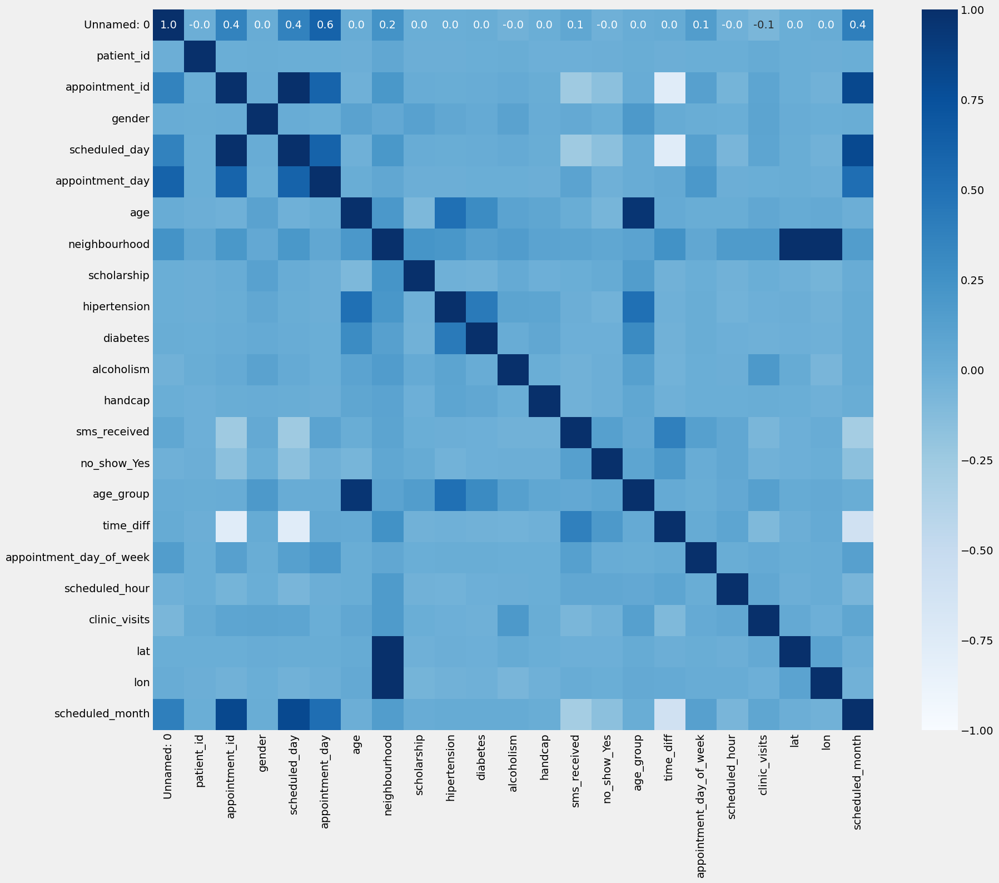

In [118]:
#show the corr of features
from dython.nominal import associations
associations(df,filename='test.png',fmt='0.1f',figsize=(20,16),annot=True,cmap='Blues')
plt.show()

In [120]:
df.drop('Unnamed: 0',axis=1,inplace=True)

In [123]:
df.reset_index(drop=True,inplace=True)

In [126]:
scatter_max=df.drop(['patient_id','appointment_id'],axis=1)

In [136]:
from dash import Dash,html,Input,Output,dcc
app=Dash()
app.layout=html.Div([
    html.H1('Analysis of patient data using scatter maxrix'),
    dcc.Dropdown(
        id='drop',
        options=list(scatter_max.drop('no_show_Yes',axis=1)),
        value=['age','sms_received'],
        multi=True,
    ),
    dcc.Graph(id='plot')
])
@app.callback(
    Output('plot','figure'),
    Input('drop','value')
)
def update_fig(dims):
    df=scatter_max
    fig=px.scatter_matrix(df,dimensions=dims,color='no_show_Yes')
    return fig

app.run_server(debug=True)

In [137]:
df.to_csv('../data/processed/patient_EDR.csv')